# Customer segmentation
### To design marketing strategy and increase sales 

![alt text](https://doughroller-wpengine.netdna-ssl.com/wp-content/uploads/2017/12/The-Best-2.png)

# INTRODUCTION

Market segmentation is a strategy that divides a broad target market of customers into smaller, more similar groups, and then designs a marketing strategy specifically for each group. Clustering is a common technique for market segmentation since it automatically finds similar groups given a data set.

In this problem, we'll see how clustering can be used to find similar groups of customers who belong to an airline's frequent flyer program. The airline is trying to learn more about its customers so that it can target different customer segments with different types of mileage offers.

<h3>The Dataset</h3>

The file FlyerData.csv contains information on 3,999 members of the frequent flyer program. This data comes from the textbook "Data Mining for Business Intelligence," by Galit Shmueli, Nitin R. Patel, and Peter C. Bruce.

<p>There are seven different variables in the dataset, described below:</p>
</p>

- Balance = number of miles eligible for award travel
- QualMiles = number of miles qualifying for TopFlight status
- BonusTrans = number of non-flight bonus transactions in the past 12 months
- FlightMiles = number of flight miles in the past 12 months
- FlightTrans = number of flight transactions in the past 12 months
- DaysSinceEnroll = number of days since enrolled in the frequent flyer program

In [1]:
# import jtplot module in notebook
from jupyterthemes import jtplot
jtplot.style(theme='onedork')
#jtplot.style(context='talk', fscale=1.4, spines=False, gridlines='--')


## Load data

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline 
import pandas as pd
import numpy as np
df = pd.read_csv('FlyerData.csv') #Public data
X=df.as_matrix().astype(float) # convert dataframe into matrix
print(X)

[[  2.81430000e+04   0.00000000e+00   1.74000000e+02 ...,   0.00000000e+00
    0.00000000e+00   7.00000000e+03]
 [  1.92440000e+04   0.00000000e+00   2.15000000e+02 ...,   0.00000000e+00
    0.00000000e+00   6.96800000e+03]
 [  4.13540000e+04   0.00000000e+00   4.12300000e+03 ...,   0.00000000e+00
    0.00000000e+00   7.03400000e+03]
 ..., 
 [  7.35970000e+04   0.00000000e+00   2.54470000e+04 ...,   0.00000000e+00
    0.00000000e+00   1.40200000e+03]
 [  5.48990000e+04   0.00000000e+00   5.00000000e+02 ...,   5.00000000e+02
    1.00000000e+00   1.40100000e+03]
 [  3.01600000e+03   0.00000000e+00   0.00000000e+00 ...,   0.00000000e+00
    0.00000000e+00   1.39800000e+03]]


In [3]:
df.describe() #data summary

,Balance,QualMiles,BonusMiles,BonusTrans,FlightMiles,FlightTrans,DaysSinceEnroll
count,3.999000e+03,3999.000000,3999.000000,3999.00000,3999.000000,3999.000000,3999.00000
mean,7.360133e+04,144.114529,17144.846212,11.60190,460.055764,1.373593,4118.55939
std,1.007757e+05,773.663804,24150.967826,9.60381,1400.209171,3.793172,2065.13454
min,0.000000e+00,0.000000,0.000000,0.00000,0.000000,0.000000,2.00000
25%,1.852750e+04,0.000000,1250.000000,3.00000,0.000000,0.000000,2330.00000
50%,4.309700e+04,0.000000,7171.000000,12.00000,0.000000,0.000000,4096.00000
75%,9.240400e+04,0.000000,23800.500000,17.00000,311.000000,1.000000,5790.50000
max,1.704838e+06,11148.000000,263685.000000,86.00000,30817.000000,53.000000,8296.00000


In [4]:
df.head()

,Balance,QualMiles,BonusMiles,BonusTrans,FlightMiles,FlightTrans,DaysSinceEnroll
0,28143,0,174,1,0,0,7000
1,19244,0,215,2,0,0,6968
2,41354,0,4123,4,0,0,7034
3,14776,0,500,1,0,0,6952
4,97752,0,43300,26,2077,4,6935


In [5]:
df.info() # data some statistics

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3999 entries, 0 to 3998
Data columns (total 7 columns):
Balance            3999 non-null int64
QualMiles          3999 non-null int64
BonusMiles         3999 non-null int64
BonusTrans         3999 non-null int64
FlightMiles        3999 non-null int64
FlightTrans        3999 non-null int64
DaysSinceEnroll    3999 non-null int64
dtypes: int64(7)
memory usage: 218.8 KB


### Histogram

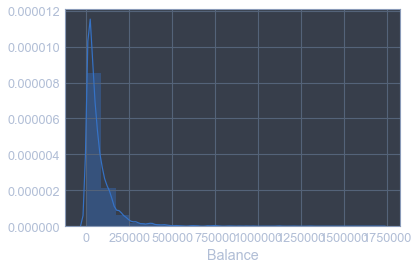

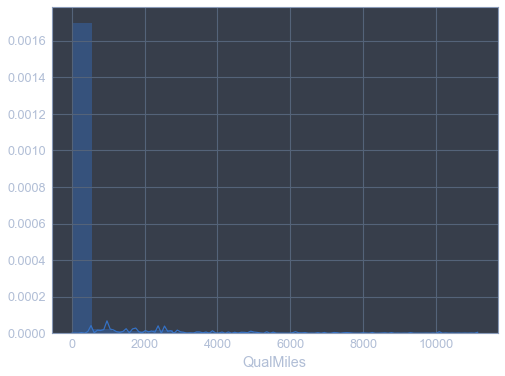

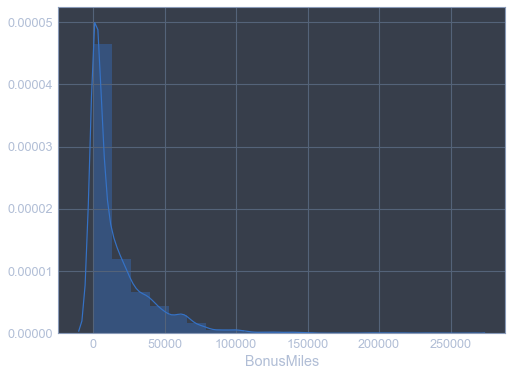

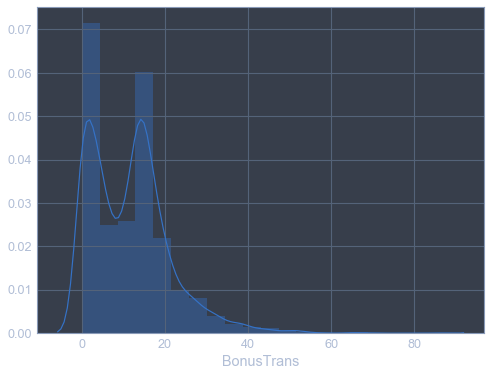

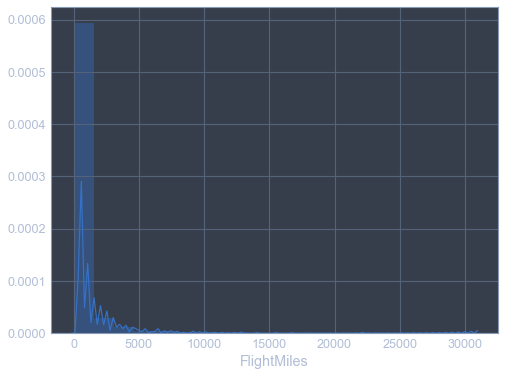

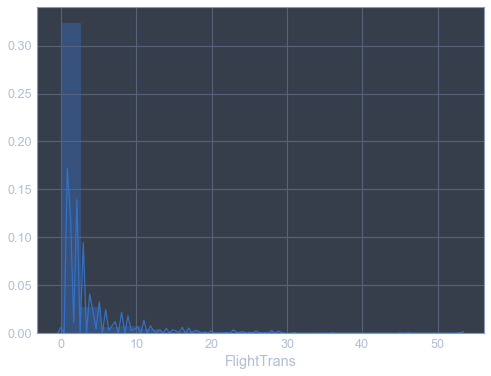

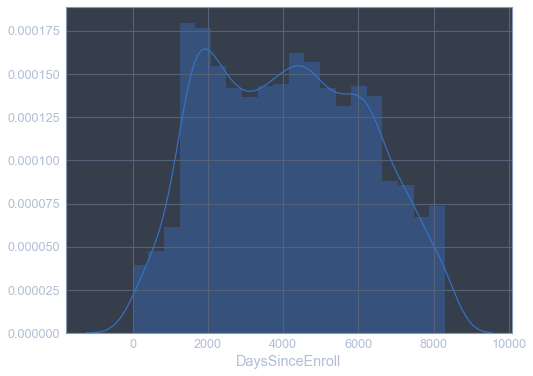

In [6]:
features = df.keys()
for i in range(0, 7):
    sns.distplot(df[features[i]], bins=20)
    plt.show()
    plt.figure(figsize=(8, 6)) 
    
# Get histograms of each data variable 

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f827a96e438>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x7f827a9cd128>]], dtype=object)

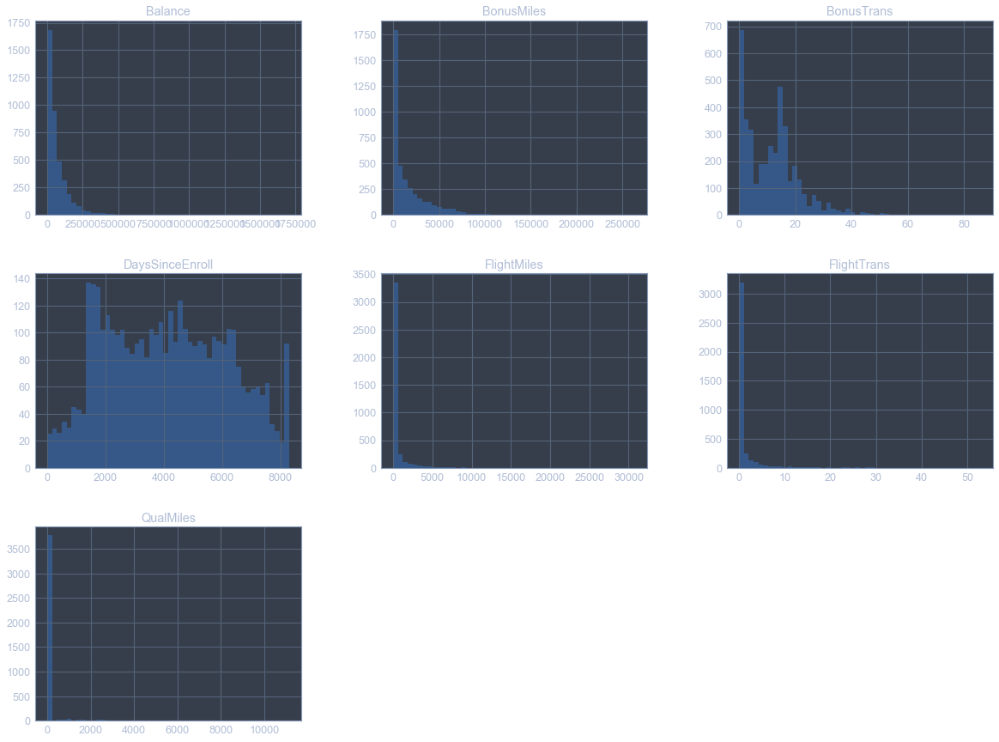

In [7]:
## Others methode
df.hist(color='b', alpha=0.5, bins=50,figsize=(20, 15))

# Normalize data

If we don't normalize the data, the variables that are on a larger scale will contribute much more to the distance calculation, and thus will dominate the clustering.

In [8]:
from sklearn import preprocessing

std_scale = preprocessing.StandardScaler().fit(df[['Balance','QualMiles','BonusMiles','BonusTrans','FlightMiles','FlightTrans','DaysSinceEnroll']])
df_std = std_scale.transform(df[['Balance','QualMiles','BonusMiles','BonusTrans','FlightMiles','FlightTrans','DaysSinceEnroll']])

###We normalize data to permit objective functions in some machine learning algorithms work properly

In [9]:
## VERIFICATION ##

print('Mean after standardization:\nBalance={:.2f}, QualMiles={:.2f}, BonusMiles={:.2f}, BonusTrans={:.2f}, FlightMiles={:.2f}, FlightTrans={:.2f}, DaysSinceEnroll={:.2f}'
      .format(df_std[:,0].mean(), df_std[:,1].mean(), df_std[:,2].mean(), df_std[:,3].mean(), df_std[:,4].mean(), df_std[:,5].mean(), df_std[:,6].mean()))
print('\nStandard deviation after standardization:\nBalance={:.2f}, QualMiles={:.2f}, BonusMiles={:.2f}, BonusTrans={:.2f}, FlightMiles={:.2f}, FlightTrans={:.2f}, DaysSinceEnroll={:.2f}'
      .format(df_std[:,0].std(), df_std[:,1].std(), df_std[:,2].std(), df_std[:,3].std(), df_std[:,4].std(), df_std[:,5].std(), df_std[:,6].std()))

Mean after standardization:
Balance=0.00, QualMiles=0.00, BonusMiles=-0.00, BonusTrans=-0.00, FlightMiles=0.00, FlightTrans=0.00, DaysSinceEnroll=0.00

Standard deviation after standardization:
Balance=1.00, QualMiles=1.00, BonusMiles=1.00, BonusTrans=1.00, FlightMiles=1.00, FlightTrans=1.00, DaysSinceEnroll=1.00


In [10]:
df2=pd.DataFrame(data=df_std) 
print(df2.describe())
print(np.shape(df_std))
df2.columns=['Balance', 'QualMiles', 'BonusMiles', 'BonusTrans', 'FlightMiles','FlightTrans' ,'DaysSinceEnroll']

                  0             1             2             3             4  \
count  3.999000e+03  3.999000e+03  3.999000e+03  3.999000e+03  3.999000e+03   
mean   5.756558e-16 -7.588884e-17 -5.515024e-16 -2.877696e-15  5.781822e-16   
std    1.000125e+00  1.000125e+00  1.000125e+00  1.000125e+00  1.000125e+00   
min   -7.304396e-01 -1.862987e-01 -7.099918e-01 -1.208203e+00 -3.286033e-01   
25%   -5.465676e-01 -1.862987e-01 -6.582276e-01 -8.957878e-01 -3.286033e-01   
50%   -3.027332e-01 -1.862987e-01 -4.130308e-01  4.145743e-02 -3.286033e-01   
75%    1.866028e-01 -1.862987e-01  2.756198e-01  5.621492e-01 -1.064658e-01   
max    1.618884e+01  1.422486e+01  1.020957e+01  7.747696e+00  2.168300e+01   

                  5             6  
count  3.999000e+03  3.999000e+03  
mean  -1.206323e-15  1.406727e-15  
std    1.000125e+00  1.000125e+00  
min   -3.621679e-01 -1.993611e+00  
25%   -3.621679e-01 -8.661823e-01  
50%   -3.621679e-01 -1.092530e-02  
75%   -9.850333e-02  8.097050e-01  


## PCA

we can now apply PCA to the scaled data to discover which dimensions about the data best maximize the variance of features involved. In addition to finding these dimensions, PCA will also report the explained variance ratio of each dimension, how much variance within the data is explained by that dimension alone.

In [11]:
# PCA decomposition 
from sklearn.decomposition import PCA

# Apply PCA by fitting the good data with only two dimensions
nb_components=2
pca = PCA(n_components=nb_components)
pca.fit(df_std)

# Transform the good data using the PCA fit above
df_pca=pca.transform(df_std)

# Clustering

In [12]:
from sklearn.metrics import silhouette_samples, silhouette_score
from __future__ import print_function
from plotly import tools
from sklearn.cluster import KMeans
import matplotlib.cm as cm
import plotly.graph_objs as go
import matplotlib

# Silouhette analysis showing the number of clusters k (using K-Means)
http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html

## Advantages K-Means:

- Robust and easy to understand.
- Relatively computational efficient.
- Delivers a great result when data points are distinct or groups within are well separated from each other.

In [13]:
%matplotlib inline 
print(__doc__)
figures = []

range_n_clusters = [2, 3, 4, 5, 6] # TODO X=...
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig = tools.make_subplots(rows=1, cols=2,
                              print_grid=False,
                              subplot_titles=('The silhouette plot for the various clusters.',
                                              'The visualization of the clustered data.'))

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    fig['layout']['xaxis1'].update(title='The silhouette coefficient values',
                                   range=[-0.1, 1])
   
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    fig['layout']['yaxis1'].update(title='Cluster label',
                                   showticklabels=False,
                                   range=[0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(df_std)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(df_std, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(df_std, cluster_labels)
    y_lower = 10
    
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        colors = cm.spectral(cluster_labels.astype(float) / n_clusters)
        
        filled_area = go.Scatter(y=np.arange(y_lower, y_upper),
                                 x=ith_cluster_silhouette_values,
                                 mode='lines',
                                 showlegend=False,
                                 line=dict(width=0.5,
                                          color=colors),
                                 fill='tozerox')
        fig.append_trace(filled_area, 1, 1)
        
        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
        

    # The vertical line for average silhouette score of all the values
    axis_line = go.Scatter(x=[silhouette_avg],
                           y=[0, len(X) + (n_clusters + 1) * 10],
                           showlegend=False,
                           mode='lines',
                           line=dict(color="red", dash='dash',
                                     width =1) )

    fig.append_trace(axis_line, 1, 1)
    
    # 2nd Plot showing the actual clusters formed
    colors = matplotlib.colors.colorConverter.to_rgb(cm.spectral(float(i) / n_clusters))
    colors = 'rgb'+str(colors)
    clusters = go.Scatter(x=df_pca[:, 0], 
                          y=df_pca[:, 1], 
                          showlegend=False,
                          mode='markers',
                          marker=dict(color=colors,
                                     size=4)
                         )
    fig.append_trace(clusters, 1, 2)
    
    # Labeling the clusters
    centers_ = clusterer.cluster_centers_
    centers_pca = pca.transform(centers_)
    # Draw white circles at cluster centers
    centers = go.Scatter(x=centers_pca[:, 0], 
                         y=centers_pca[:, 1],
                         showlegend=False,
                         mode='markers',
                         marker=dict(color='green', size=10,
                                     line=dict(color='black',
                                                             width=1))
                        )

    fig.append_trace(centers, 1, 2)
    
    fig['layout']['xaxis2'].update(title='Feature space for the 1st feature',
                                   zeroline=False)
    fig['layout']['yaxis2'].update(title='Feature space for the 2nd feature',
                                  zeroline=False)
                              

    fig['layout'].update(title="Silhouette analysis for KMeans clustering on sample data "
                         "with n_clusters = %d" % n_clusters)
    
    figures.append(fig)

Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.548290436803
For n_clusters = 3 The average silhouette_score is : 0.312211728661
For n_clusters = 4 The average silhouette_score is : 0.318614970271
For n_clusters = 5 The average silhouette_score is : 0.249000880479
For n_clusters = 6 The average silhouette_score is : 0.258572025301


In [14]:
import plotly.plotly as py
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=False)
iplot(figures[0]) # plot the silhouette with n_clusters = 2 

In [15]:
iplot(figures[0]) # plot the silhouette with n_clusters = 2

In [16]:
iplot(figures[1]) # plot the silhouette with n_clusters = 3

In [17]:
iplot(figures[2])# plot the silhouette with n_clusters = 4

In [18]:
iplot(figures[3])# plot the silhouette with n_clusters = 5

## Elbow approach 

Showing the number of clusters k

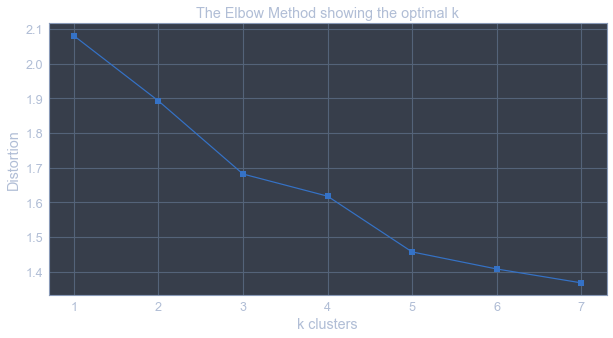

The elbow method looks at the percentage of variance explained as a function of the number of clusters


In [19]:
# The elbow method looks at the percentage of variance explained as a function of the number of clusters

from scipy.spatial.distance import cdist
import seaborn
distortions = []
K = range(1,8)

for k in K:
    kmeanModel = KMeans(n_clusters=k).fit(df_std)
    kmeanModel.fit(df_std)
    distortions.append(sum(np.min(cdist(df_std, kmeanModel.cluster_centers_, 'euclidean'), axis=1)) / df_std.shape[0])

    
# Plot the elbow
plt.figure(figsize=(10, 5))
plt.plot(K, distortions,'bs-')
plt.xlabel('k clusters')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()
print('The elbow method looks at the percentage of variance explained as a function of the number of clusters')

# Hierarchical clustering

<function matplotlib.pyplot.show>

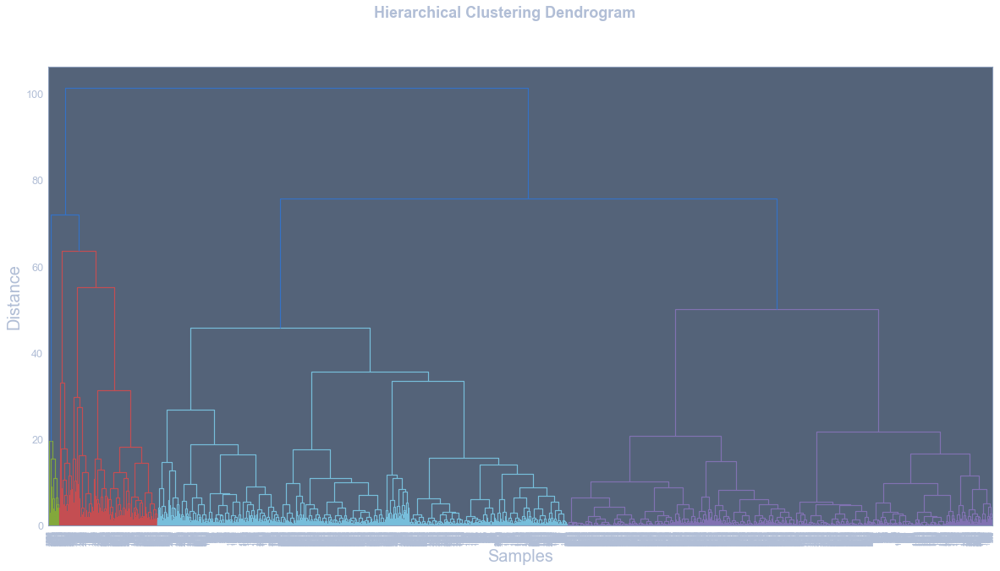

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram
 # TODO
data_dist = pdist(df_std) # computing the distance
data_link = linkage(data_dist,'ward',metric='euclidean')  # computing the linkage  # TODO
plt.figure(figsize=(20, 10))
dendrogram(data_link, leaf_rotation=90.,leaf_font_size=8.)#,labels=df.dtype.names)
plt.xlabel('Samples', fontsize=20)
plt.ylabel('Distance', fontsize=20)
plt.suptitle('Hierarchical Clustering Dendrogram', fontweight='bold', fontsize=18);
plt.show

## Dimensionality reduction for further visualization

When using principal component analysis, one of the main goals is to reduce the dimensionality of the data. In effect, reducing the complexity of the problem. Dimensionality reduction comes at a cost: Fewer dimensions used implies less of the total variance in the data is being explained. Because of this, the cumulative explained variance ratio is extremely important for knowing how many dimensions are necessary for the problem. Additionally, if a signifiant amount of variance is explained by only two or three dimensions, the reduced data can be visualized afterwards.

[ 0.37900807  0.19482266  0.14125791  0.12320316  0.09373914  0.05003811]
[1 2 3 4 5 6]


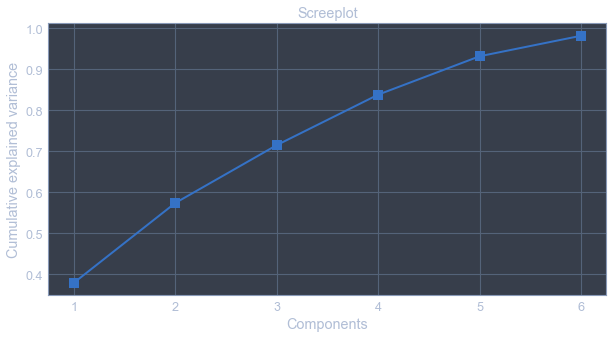

As far, we used PCA decomposition in 2D for data visualization, but let s study now how many data we lost by reducing the dimensiality


In [21]:
from sklearn.decomposition import PCA
import seaborn

nb_components=6 #
pca = PCA(n_components=nb_components,copy=True, whiten=True)
pca.fit(df_std)
df_reduced = pca.transform(df_std)
print(pca.explained_variance_ratio_)

#the results on PCA-reduced data


x=np.arange(1,nb_components+1)
print(x)
y=pca.explained_variance_ratio_
plt.figure()
plt.figure(figsize=(10,5))
plt.plot(x,np.cumsum(y),'bs-',linewidth=2.0,markersize=10.0)
plt.xlabel('Components')
plt.ylabel('Cumulative explained variance')
plt.title('Screeplot')
plt.show()
print('As far, we used PCA decomposition in 2D for data visualization, but let s study now how many data we lost by reducing the dimensiality')

#### with 2 features we have less than 60 % of data;
#### with 3 features we have less approximatively 72% of data;
#### with 4 fetures we have  approximatively 85% of data, etc. 

## Hierarchical Clustering visualizaion

{1, 2, 3, 4, 5}


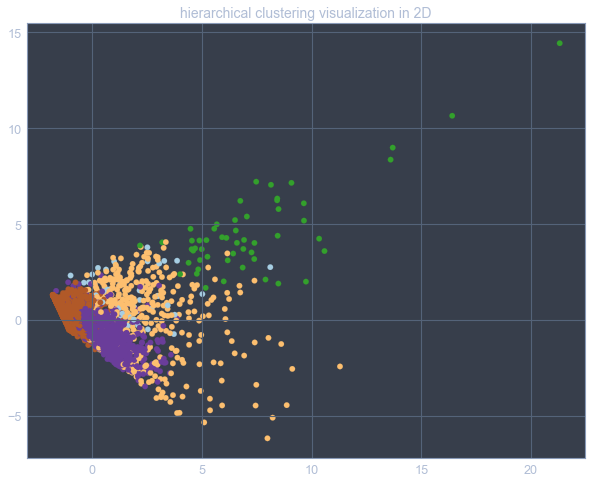

In [22]:
# transform the dendrogram to flat clusters in order to visualize

from scipy.cluster.hierarchy import fcluster
max_d = 60 #Threshold
clusters = fcluster(data_link, max_d, criterion='distance')
#clusters
myset = set(clusters)
print(myset)

plt.figure(figsize=(10, 8))
plt.scatter(df_pca[:,0], df_pca[:,1], c=clusters,cmap=plt.cm.Paired)  # plot points with cluster dependent colors
plt.title('hierarchical clustering visualization in 2D',fontsize=14)
plt.show()

## Hierarchical clustering statistics

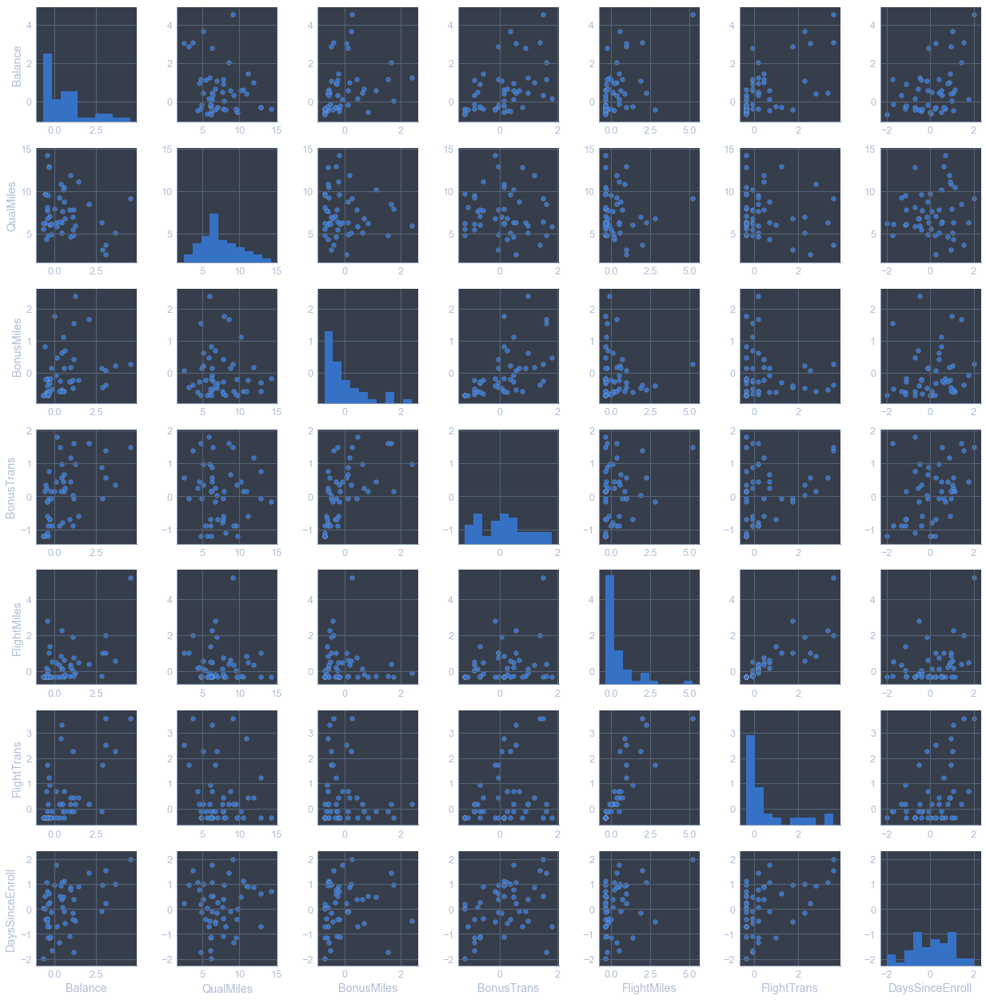

In [23]:
#perform pairplot of data samples that are in cluser 1
import seaborn as sns
Yc1=df_std[clusters==1] #1:cluster1, 2:cluster2, etc
dfYc1 = pd.DataFrame(data=Yc1,columns=df.columns)  
sns.pairplot(dfYc1); # see http://seaborn.pydata.org/generated/seaborn.pairplot.html#seaborn.pairplot to know more about pairplot

# K-MEANS

In [24]:
from sklearn import metrics
from sklearn.cluster import KMeans

kmeans = KMeans(init='k-means++', n_clusters=5, n_init=20) #perform the kmeans clustering

y_km = kmeans.fit(df_std)
print(y_km)

y_pred = kmeans.fit_predict(df_std)
print(y_pred)




KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=20, n_jobs=1, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)
[2 2 2 ..., 0 0 0]


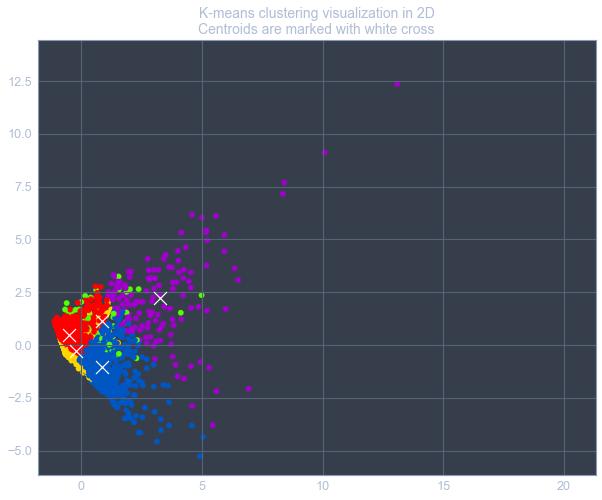

In [25]:
%matplotlib inline
import seaborn

# plot kmeans clusters
plt.figure(figsize=(10, 8))

plt.scatter(df_reduced[:,0], df_reduced[:,1], c=y_pred, cmap='prism')
centroids = kmeans.cluster_centers_

# plot kmeans centroid
centroids_pca = pca.transform(kmeans.cluster_centers_)
plt.scatter(centroids_pca[:, 0], centroids_pca[:, 1],
            marker='x', s=169, linewidths=3,
            color='w', zorder=10)
plt.title('K-means clustering visualization in 2D\n'
          'Centroids are marked with white cross',fontsize=14)
x_min=np.min(df_pca[:,0])
x_max=np.max(df_pca[:,0])
y_min=np.min(df_pca[:,1])
y_max=np.max(df_pca[:,1])
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.show()

# k-means Clusters interpretation

In [26]:
clusters_labels = y_pred # data labeled regarding clusters
clusters_centroid = kmeans.cluster_centers_ # clusters centers or centroids
clusters_inertia = kmeans.inertia_  #Sum of squared distances of samples to their closest cluster center

### Data repartition in each cluster

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f827a003c18>]], dtype=object)

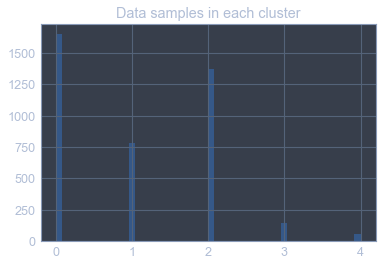

In [27]:
df3=pd.DataFrame(data=clusters_labels,columns=['Data samples in each cluster']) 
df3.hist(color='b', alpha=0.5, bins=50)

Data samples are likely more localised in clusters 0,1 and 2

### Variables average values in each cluster

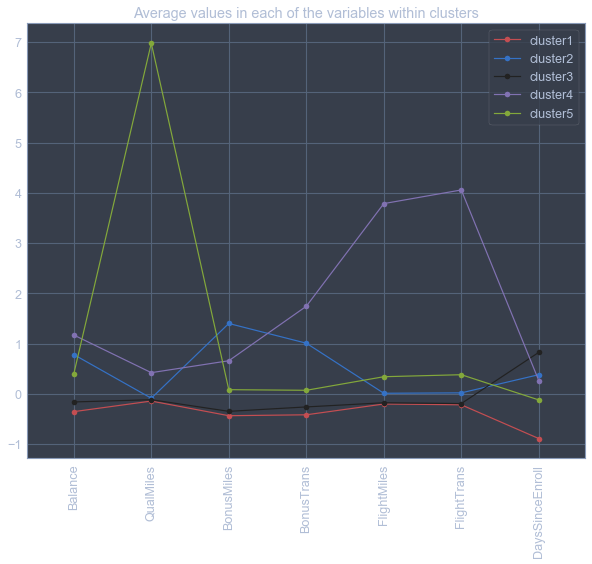

In [28]:
labels=df.columns.values
N=7
ind = np.arange(N)
plt.figure(figsize=(10, 8))
plt.plot((df_std[clusters_labels==0]).mean(axis=0),'-ro',label='cluster1')
plt.plot((df_std[clusters_labels==1]).mean(axis=0),'-bo',label='cluster2')
plt.plot((df_std[clusters_labels==2]).mean(axis=0),'-ko',label='cluster3')
plt.plot((df_std[clusters_labels==3]).mean(axis=0),'-mo',label='cluster4')
plt.plot((df_std[clusters_labels==4]).mean(axis=0),'-go',label='cluster5')
plt.xticks(ind,labels, rotation='vertical')
plt.margins(x=0.1)
plt.title('Average values in each of the variables within clusters')
plt.legend()
plt.show()

## What are the largest average values of data variables for each cluster ?


- Cluster 1 has the largest average values in FlightMiles
- Cluster 2 has the largest average values in BonusMiles
- Cluster 3 has the largest average values in DaysSinceEnroll
- Cluster 4 has the largest average values in FlightTrans
- Cluster 5 has the largest average values in QualMiles


# How could you qualify the customers of each cluster ?

- Cluster 1, doesn't have the largest values in any of the variables. This implies that cluster 1 has relatively new customers (since they have the smallest value in 'DaysSinceEnroll') who seem to be accumulating miles mostly through non-flight transactions.


- On the same plot, cluster 2 has the largest average values in 'Balance', 'BonusMiles', and 'BonusTrans'. While it also has relatively large values in other variables, these are the three for which it has the largest values. This implies that cluster 2 has customers who have accumulated a large amount of miles, mostly through non-flight transactions.


- Cluster 3, likewise, doesn't have the largest values in any of the variables. This implies that cluster 3 has relatively new customers who don't use the airlines very often.(Since they have lower than average values in all the variables, excepted 'DaysSinceEnroll' where we have a relatively large value).


- Similarly, cluster 4 has the largest average values for the variables 'FlightMiles' and 'FlightTrans'. This cluster also has relatively large values in 'QualMiles', BonusMiles', 'BonusTrans' and 'Balance'. This implies that cluster 4 has customers who have accumulated a large amount of miles, mostly through flight transactions.


- Compared to other clusters, cluster 5 has the largest average value for 'QualMiles'. This implies that cluster 5 has  customers who have miles through Top flight status.


<h3>Results</h3>
<p>We segmented the frequent flyers of an airline into clusters for targeted marketing and we were able to identify 5 unique clusters with varying properties.</p>

- Cluster 1: new customers procuring miles through non-flight transactions
- Cluster 2: customers with huge miles procured through non-flight transactions
- Cluster 3: infrequent and new but almost loyal customers
- Cluster 4: customers with huge miles procured through flight transactions
- Cluster 5: customers procuring miles through Top flight status.


